##Dennies Bor
###Custom Image Classifier

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
import shutil
import cv2
# !pip3 install jedi==0.17.2

In [ ]:
from google.colab import drive
drive.mount('/content/drive',force_remount=True)

Mounted at /content/drive


Files are copied from the phone's camera, annotated with `labelImg`, and annotations in xml format converted to csv format consisting of xmin,ymin,xmax,ymax and class

In [ ]:
RAWFILES = '/content/drive/MyDrive/Twist_Chellenge/data'
TRAIN_IMGS = '/content/drive/MyDrive/Twist_Chellenge/data/images/train'
TEST_IMGS = '/content/drive/MyDrive/Twist_Chellenge/data/images/test'
TRAIN_LABELS_CSV = '/content/drive/MyDrive/Twist_Chellenge/data/train_labels.csv'
TEST_LABELS_CSV = '/content/drive/MyDrive/Twist_Chellenge/data/test_labels.csv'

In [ ]:
# read the train and test csv
train_df = pd.read_csv(TRAIN_LABELS_CSV)
test_df = pd.read_csv(TEST_LABELS_CSV)

In [ ]:
# show head of the data
train_df.head(5)

,filename,width,height,class,xmin,ymin,xmax,ymax
0,IMG_20220209_072412.jpg,3444,1720,risk,91,1029,676,1690
1,IMG_20220209_072658.jpg,2372,2836,risk,1132,1241,1529,1524
2,IMG_20220209_073401.jpg,2012,1504,risk,584,57,1485,527
3,IMG_20220209_073401.jpg,2012,1504,risk,150,72,575,618
4,IMG_20220209_073337.jpg,3712,2788,risk,1431,1797,2754,2757


In [ ]:
test_df.head(5)

,filename,width,height,class,xmin,ymin,xmax,ymax
0,IMG_20220209_072618.jpg,2708,2688,risk,1709,666,2631,1308
1,IMG_20220209_073239.jpg,3148,1656,risk,308,1071,803,1542
2,IMG_20220209_073239.jpg,3148,1656,risk,1603,729,1999,1240
3,IMG_20220209_073239.jpg,3148,1656,risk,2499,880,2837,1267
4,IMG_20220209_073239.jpg,3148,1656,risk,1441,387,1710,1100


In [ ]:
# CREATE WORKING DIRECTORY AFTER CLEANING

# define directories
# A python script to make necessary directories:

# makes the working directory given the root dir and the subdir name

def make_dirs(workdirname):
    file_path = '/content/drive/MyDrive/Twist_Chellenge'
    WORKDIRNAME = workdirname
    WORKDIR = os.path.join(file_path,WORKDIRNAME)
    TRAINIGDIR = os.path.join(WORKDIR,'TRAINIGDIR')
    models = os.path.join(WORKDIR,'models')
    DATA = os.path.join(WORKDIR,'DATA')
    TRAIN = os.path.join(DATA,'TRAIN')
    TEST = os.path.join(DATA,'TEST')
    VALID = os.path.join(DATA,'VALID')
    PRETRAINEDMODEL = os.path.join(DATA,'PRETRAINEDMODEL')
    INFERENCE = os.path.join(WORKDIR,'INFERENCE')
    frozen_model = os.path.join(INFERENCE,'frozen_model')

    if os.path.exists(file_path):
        if not os.path.exists(os.path.join(file_path,WORKDIRNAME)):
            os.mkdir(WORKDIR)
        if not os.path.exists(TRAINIGDIR):
            os.mkdir(TRAINIGDIR)
        if not os.path.exists(models):
            os.mkdir(models)
        if not os.path.exists(DATA):
            os.mkdir(DATA)
        if not os.path.exists(INFERENCE):
            os.mkdir(INFERENCE)
        if not os.path.exists(frozen_model):
            os.mkdir(frozen_model)
        if os.path.exists(DATA):
            if not os.path.exists(TRAIN):
                os.mkdir(TRAIN)  
            if not os.path.exists(TEST):
                os.mkdir(TEST)
            if not os.path.exists(TEST):
                os.mkdir(TEST)
            if not os.path.exists(VALID):
                os.mkdir(VALID)
            if not os.path.exists(PRETRAINEDMODEL):
                os.mkdir(PRETRAINEDMODEL)
    else:
        print("The file doesn't exist")
    return (WORKDIRNAME,WORKDIR,TRAINIGDIR,models,DATA,TRAIN,TEST,VALID,PRETRAINEDMODEL,INFERENCE,frozen_model)

WORKDIRNAME,WORKDIR,TRAINIGDIR,models,DATA,TRAIN,TEST,VALID,PRETRAINEDMODEL,INFERENCE,frozen_model = make_dirs(workdirname='SSD')

In [ ]:
train_df.shape

(29, 8)

In [ ]:
test_df.shape

(19, 8)

In [ ]:
train_df.head(5)

,filename,width,height,class,xmin,ymin,xmax,ymax
0,IMG_20220209_072412.jpg,3444,1720,risk,91,1029,676,1690
1,IMG_20220209_072658.jpg,2372,2836,risk,1132,1241,1529,1524
2,IMG_20220209_073401.jpg,2012,1504,risk,584,57,1485,527
3,IMG_20220209_073401.jpg,2012,1504,risk,150,72,575,618
4,IMG_20220209_073337.jpg,3712,2788,risk,1431,1797,2754,2757


In [ ]:
# extract full path to the images in the filename section
train_data = train_df.copy()
test_data = test_df.copy()

test_data['filename'] = test_data['filename'].apply(lambda x: f"/content/drive/MyDrive/Twist_Chellenge/data/images/test/{x}")
train_data['filename'] = train_data['filename'].apply(lambda x: f"/content/drive/MyDrive/Twist_Chellenge/data/images/train/{x}")

In [ ]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29 entries, 0 to 28
Data columns (total 8 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   filename  29 non-null     object
 1   width     29 non-null     int64 
 2   height    29 non-null     int64 
 3   class     29 non-null     object
 4   xmin      29 non-null     int64 
 5   ymin      29 non-null     int64 
 6   xmax      29 non-null     int64 
 7   ymax      29 non-null     int64 
dtypes: int64(6), object(2)
memory usage: 1.9+ KB


In [ ]:
# installing the object detection api
# cd working directory
os.chdir(WORKDIR)

!git clone https://github.com/tensorflow/models.git

# move the models to our preferred dir

Cloning into 'models'...
remote: Enumerating objects: 68970, done.
remote: Counting objects: 100% (8/8), done.
remote: Compressing objects: 100% (5/5), done.
remote: Total 68970 (delta 2), reused 6 (delta 2), pack-reused 68962
Receiving objects: 100% (68970/68970), 577.21 MiB | 12.03 MiB/s, done.
Resolving deltas: 100% (48621/48621), done.
Checking out files: 100% (2900/2900), done.


In [ ]:
!pip uninstall --yes tensorflow
!pip install tensorflow==2.7.0

Found existing installation: tensorflow 2.8.0
Uninstalling tensorflow-2.8.0:
  Successfully uninstalled tensorflow-2.8.0
  Using cached tensorflow-2.7.0-cp37-cp37m-manylinux2010_x86_64.whl (489.6 MB)
     |████████████████████████████████| 1.3 MB 5.0 MB/s 
  Attempting uninstall: keras
    Found existing installation: keras 2.8.0
    Uninstalling keras-2.8.0:
      Successfully uninstalled keras-2.8.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tf-models-official 2.8.0 requires tensorflow~=2.8.0, but you have tensorflow 2.7.0 which is incompatible.
tensorflow-text 2.8.1 requires tensorflow<2.9,>=2.8.0, but you have tensorflow 2.7.0 which is incompatible.


In [ ]:
# change wordir. you can cd or use inbuilt os change directory

os.chdir(os.path.join(models,'research'))

In [ ]:
# use protobuf to make py scrips
!protoc object_detection/protos/*.proto --python_out=.

In [ ]:
cp object_detection/packages/tf2/setup.py .

In [ ]:
!python -m pip install .

Processing /content/drive/.shortcut-targets-by-id/1U4siluh6xIwc-UeFhseuslM02xlHtTDB/Twist_Chellenge/TRAINING/models/research
  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.
  Using cached tensorflow-2.8.0-cp37-cp37m-manylinux2010_x86_64.whl (497.5 MB)
  Using cached keras-2.8.0-py2.py3-none-any.whl (1.4 MB)
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1686316 sha256=dd64e16b2127991c8ce0993b125f686b276e972e872817f2b120d5c29228477c
  Stored in directory: /tmp/pip-ephem-wheel-cache-gnnvq20v/wheels/20/e4/40/2d4a36673c2b104bba4bdc6e2c758038352a24df355f37b331
Successfully built object-detection
  Attemptin

In [ ]:
# Download the pretrained model.
# cd into the DATA, PRETRAINED

os.chdir(PRETRAINEDMODEL)
!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz

!tar -xvzf faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz
!rm -rf faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz

--2022-02-11 04:57:03--  http://download.tensorflow.org/models/object_detection/tf2/20200711/faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 209.85.234.128, 2607:f8b0:4001:c17::80
Connecting to download.tensorflow.org (download.tensorflow.org)|209.85.234.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 211996178 (202M) [application/x-tar]
Saving to: ‘faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz.1’

faster_rcnn_resnet5 100%[===================>] 202.17M  80.1MB/s    in 2.5s    

2022-02-11 04:57:06 (80.1 MB/s) - ‘faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz.1’ saved [211996178/211996178]

faster_rcnn_resnet50_v1_640x640_coco17_tpu-8/
faster_rcnn_resnet50_v1_640x640_coco17_tpu-8/checkpoint/
faster_rcnn_resnet50_v1_640x640_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
faster_rcnn_resnet50_v1_640x640_coco17_tpu-8/checkpoint/checkpoint
faster_rcnn_resnet50_v1_640x640_coco17_tpu-

In [ ]:
os.chdir(os.path.join(models,'research'))
# convert the csv files into tf records
#The file is cloned from github



# !python3 generate_tfrecord.py --path_to_images /content/drive/MyDrive/Twist_Chellenge/data/images/train \
#     --path_to_annot '/content/drive/MyDrive/Twist_Chellenge/data/train_labels.csv' \
#         --path_to_label_map '/content/drive/MyDrive/Twist_Chellenge/data/coffee_labelmap.pbtxt' \
#             --path_to_save_tfrecords '/content/drive/MyDrive/Twist_Chellenge/TRAINING/DATA/TRAIN/Train.record'

In [ ]:
# generate eval tensor flow records


!python3 generate_tfrecord.py --path_to_images /content/drive/MyDrive/Twist_Chellenge/data/images/test \
    --path_to_annot '/content/drive/MyDrive/Twist_Chellenge/data/test_labels.csv' \
        --path_to_label_map '/content/drive/MyDrive/Twist_Chellenge/data/coffee_labelmap.pbtxt' \
            --path_to_save_tfrecords '/content/drive/MyDrive/Twist_Chellenge/TRAINING/DATA/TEST/Test.record'

images path :  /content/drive/MyDrive/Twist_Chellenge/data/images/test
csv path :  /content/drive/MyDrive/Twist_Chellenge/data/test_labels.csv
path to output tfrecords :  /content/drive/MyDrive/Twist_Chellenge/TRAINING/DATA/TEST/Test.record
Generating tfrecord .... 
Successfully created the TFRecords: /content/drive/MyDrive/Twist_Chellenge/TRAINING/DATA/TEST/Test.record


In [ ]:
# solving errors associated with cv2
!pip uninstall --yes opencv-python
!pip install opencv-python==4.1.2.30

Found existing installation: opencv-python 4.1.2.30
Uninstalling opencv-python-4.1.2.30:
  Successfully uninstalled opencv-python-4.1.2.30
  Using cached opencv_python-4.1.2.30-cp37-cp37m-manylinux1_x86_64.whl (28.3 MB)
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


In [ ]:
!pip uninstall --yes tensorflow
!pip install tensorflow==2.7.0

Found existing installation: tensorflow 2.8.0
Uninstalling tensorflow-2.8.0:
  Successfully uninstalled tensorflow-2.8.0
  Using cached tensorflow-2.7.0-cp37-cp37m-manylinux2010_x86_64.whl (489.6 MB)
  Using cached keras-2.7.0-py2.py3-none-any.whl (1.3 MB)
  Attempting uninstall: keras
    Found existing installation: keras 2.8.0
    Uninstalling keras-2.8.0:
      Successfully uninstalled keras-2.8.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tf-models-official 2.8.0 requires tensorflow~=2.8.0, but you have tensorflow 2.7.0 which is incompatible.
tensorflow-text 2.8.1 requires tensorflow<2.9,>=2.8.0, but you have tensorflow 2.7.0 which is incompatible.


In [34]:
# run train scripts
!chmod +x training_scripts.sh
!bash training_scripts.sh

2022-02-11 06:41:50.904902: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
W0211 06:41:50.907121 139763122505600 cross_device_ops.py:1387] There are non-GPU devices in `tf.distribute.Strategy`, not using nccl allreduce.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:CPU:0',)
I0211 06:41:50.908491 139763122505600 mirrored_strategy.py:376] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:CPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: None
I0211 06:41:51.196198 139763122505600 config_util.py:552] Maybe overwriting train_steps: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0211 06:41:51.196498 139763122505600 config_util.py:552] Maybe overwriting use_bfloat16: False
Instructions for updating:
rename to distribute_datasets_from_function
W0211 06:41:51.247092 139763122505600 deprecation.py:347] From /usr/local/

KeyboardInterrupt: ignored

In [36]:
!chmod +x eval_scripts.sh
!bash eval_scripts.sh

2022-02-11 08:36:41.806747: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
W0211 08:36:41.837762 140105463609216 model_lib_v2.py:1090] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I0211 08:36:41.838374 140105463609216 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0211 08:36:41.838558 140105463609216 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I0211 08:36:41.838699 140105463609216 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W0211 08:36:41.838968 140105463609216 model_lib_v2.py:1111] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `num_epochs` to 1.
INFO:tensorflow:Reading unweighted datase

In [38]:
# load the training logs with tensorboard
# Load the TensorBoard notebook extension
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [40]:
%cd {VALID}
%tensorboard --logdir train

/content/drive/MyDrive/Twist_Chellenge/SSD/DATA/VALID


<IPython.core.display.Javascript object>

In [41]:
%tensorboard --logdir train

Reusing TensorBoard on port 6007 (pid 1595), started 0:00:00 ago. (Use '!kill 1595' to kill it.)

<IPython.core.display.Javascript object>

In [43]:
%tensorboard --logdir eval

<IPython.core.display.Javascript object>

In [ ]:
cd object_detection

In [ ]:
# export the trained model as protobuff file for inference

!chmod u+x export_model.sh
!bash export_model.sh

2022-02-10 13:46:06.057817: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W0210 13:46:07.886652 140500217264000 deprecation.py:615] From /usr/local/lib/python3.7/dist-packages/tensorflow/python/autograph/impl/api.py:458: calling map_fn_v2 (from tensorflow.python.ops.map_fn) with back_prop=False is deprecated and will be removed in a future version.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
INFO:tensorflow:depth of additional conv before box predictor: 0
I0210 13:46:58.923703 14

In [ ]:
cd /content/drive/MyDrive/Twist_Chellenge/TRAINING/INFERENCE

/content/drive/.shortcut-targets-by-id/1U4siluh6xIwc-UeFhseuslM02xlHtTDB/Twist_Chellenge/TRAINING/INFERENCE


In [ ]:
# running inference
'''
The scripts to make inference. Wrirtten by Abdelrahman
at  https://github.com/abdelrahman-gaber
'''
!git clone https://github.com/abdelrahman-gaber/tf2-object-detection-api-tutorial.git
!cp tf2-object-detection-api-tutorial/detector.py tf2-object-detection-api-tutorial/detect_objects.py .
!rm -rf tf2-object-detection-api-tutorial

Cloning into 'tf2-object-detection-api-tutorial'...
remote: Enumerating objects: 503, done.
remote: Total 503 (delta 0), reused 0 (delta 0), pack-reused 503
Receiving objects: 100% (503/503), 58.95 MiB | 10.66 MiB/s, done.
Resolving deltas: 100% (220/220), done.
Checking out files: 100% (447/447), done.


In [ ]:
model = tf.keras.models.load_model('/content/drive/MyDrive/Twist_Chellenge/TRAINING/INFERENCE/frozen_model/saved_model')

NameError: ignored

In [ ]:
model = tf.saved_model.load('/content/drive/MyDrive/Twist_Chellenge/TRAINING/INFERENCE/frozen_model/saved_model')

In [ ]:
save_options = tf.saved_model.SaveOptions(experimental_io_device='/job:localhost')

In [ ]:
model.save('/content/drive/MyDrive/Twist_Chellenge/TRAINING/DATA', options=save_options)

Loading model...Done! Took 135.75619792938232 seconds
Running inference for /content/drive/MyDrive/Twist_Chellenge/data/images/test/IMG_20220209_070102.jpg... Done


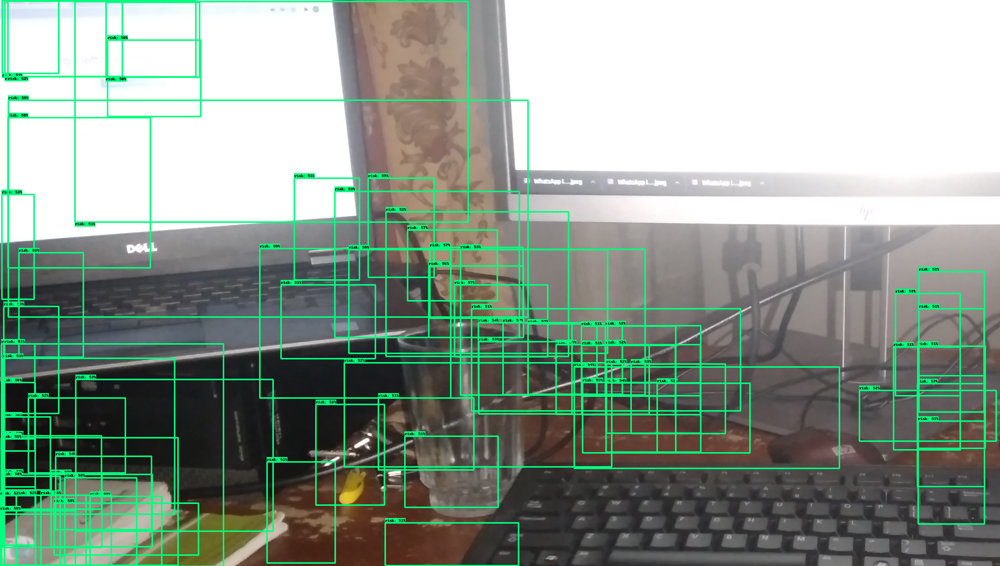

In [ ]:
"""
Object Detection (On Image) From TF2 Saved Model
=====================================
"""

import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'    # Suppress TensorFlow logging (1)
import pathlib
import tensorflow as tf
import cv2
import argparse
from google.colab.patches import cv2_imshow

# Enable GPU dynamic memory allocation
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)

# PROVIDE PATH TO IMAGE DIRECTORY
IMAGE_PATHS = '/content/drive/MyDrive/Twist_Chellenge/data/images/test/IMG_20220209_070102.jpg'


# PROVIDE PATH TO MODEL DIRECTORY
PATH_TO_MODEL_DIR = '/content/drive/MyDrive/Twist_Chellenge/TRAINING/INFERENCE/frozen_model'

# PROVIDE PATH TO LABEL MAP
PATH_TO_LABELS = '/content/drive/MyDrive/Twist_Chellenge/data/coffee_labelmap.pbtxt'

# PROVIDE THE MINIMUM CONFIDENCE THRESHOLD
MIN_CONF_THRESH = float(0.60)

# LOAD THE MODEL

import time
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils

PATH_TO_SAVED_MODEL = PATH_TO_MODEL_DIR + "/saved_model"

print('Loading model...', end='')
start_time = time.time()

# LOAD SAVED MODEL AND BUILD DETECTION FUNCTION
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)

end_time = time.time()
elapsed_time = end_time - start_time
print('Done! Took {} seconds'.format(elapsed_time))

# LOAD LABEL MAP DATA FOR PLOTTING

category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,
                                                                    use_display_name=True)

import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')   # Suppress Matplotlib warnings

def load_image_into_numpy_array(path):
    """Load an image from file into a numpy array.
    Puts image into numpy array to feed into tensorflow graph.
    Note that by convention we put it into a numpy array with shape
    (height, width, channels), where channels=3 for RGB.
    Args:
      path: the file path to the image
    Returns:
      uint8 numpy array with shape (img_height, img_width, 3)
    """
    return np.array(Image.open(path))




print('Running inference for {}... '.format(IMAGE_PATHS), end='')

image = cv2.imread(IMAGE_PATHS)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
image_expanded = np.expand_dims(image_rgb, axis=0)

# The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
input_tensor = tf.convert_to_tensor(image)
# The model expects a batch of images, so add an axis with `tf.newaxis`.
input_tensor = input_tensor[tf.newaxis, ...]

# input_tensor = np.expand_dims(image_np, 0)
detections = detect_fn(input_tensor)

# All outputs are batches tensors.
# Convert to numpy arrays, and take index [0] to remove the batch dimension.
# We're only interested in the first num_detections.
num_detections = int(detections.pop('num_detections'))
detections = {key: value[0, :num_detections].numpy()
               for key, value in detections.items()}
detections['num_detections'] = num_detections

# detection_classes should be ints.
detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

image_with_detections = image.copy()

# SET MIN_SCORE_THRESH BASED ON YOU MINIMUM THRESHOLD FOR DETECTIONS
viz_utils.visualize_boxes_and_labels_on_image_array(
      image_with_detections,
      detections['detection_boxes'],
      detections['detection_classes'],
      detections['detection_scores'],
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=0.5,
      agnostic_mode=False)

print('Done')
# DISPLAYS OUTPUT IMAGE
cv2_imshow(image_with_detections)
# CLOSES WINDOW ONCE KEY IS PRESSED
